<a href="https://colab.research.google.com/github/ParthKhairnar101/Hotel-Review-Sentiment-Analysis/blob/main/Sentiment_Analysis_of_Hotel_Reviews_NLP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install xgboost
!pip install emoji
!pip install transformers
!pip install tensorflow
!pip install demoji
!pip install pytorch-lamb
!pip install tensorflow_hub
!pip install tensorflow_text
!pip install seaborn
!pip install wordcloud

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 590.6/590.6 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.9/42.9 kB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 20.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 20.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 19.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 66.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1

In [ ]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.patches as mpatches
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import TruncatedSVD
from tqdm import tqdm

import nltk
from nltk import word_tokenize
from nltk.corpus import stopwords
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import log_loss, roc_auc_score, accuracy_score
import xgboost as xgb

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, LSTM, Bidirectional, Activation, GRU, BatchNormalization
from tensorflow.keras.layers import GlobalMaxPooling1D, Conv1D, MaxPooling1D, Flatten, Bidirectional, SpatialDropout1D
from tensorflow.keras.optimizers import Adam
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text

nltk.download('stopwords')
stop_words = stopwords.words('english')

import os

data_path = '/content'

if os.path.exists(os.path.join(data_path,"Hotel_Reviews.csv")):
  df = pd.read_csv(os.path.join(data_path,"Hotel_Reviews.csv"))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


ParserError: Error tokenizing data. C error: Expected 17 fields in line 4280, saw 22


In [ ]:
module_url = 'https://tfhub.dev/google/universal-sentence-encoder-multilingual-large/3'
use = hub.load(module_url)

# Load the data

In [ ]:
data = pd.read_csv("Hotel_Reviews.csv")
data.head()

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Ireland,No Negative,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3 days,52.360576,4.915968
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,United Kingdom,My room was dirty and I was afraid to walk ba...,210,1403,Great location in nice surroundings the bar a...,26,1,3.8,"[' Leisure trip ', ' Solo traveler ', ' Duplex...",3 days,52.360576,4.915968
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/24/2017,7.7,Hotel Arena,New Zealand,You When I booked with your company on line y...,140,1403,Amazing location and building Romantic setting,8,3,6.7,"[' Leisure trip ', ' Couple ', ' Suite ', ' St...",10 days,52.360576,4.915968


In [ ]:
print(data.shape[0])

print(len(data))  # Number of rows

515738
515738


In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Additional_Number_of_Scoring,515738.0,498.081836,500.538467,1.000000,169.000000,341.000000,660.000000,2682.000000
Average_Score,515738.0,8.397487,0.548048,5.200000,8.100000,8.400000,8.800000,9.800000
Review_Total_Negative_Word_Counts,515738.0,18.539450,29.690831,0.000000,2.000000,9.000000,23.000000,408.000000
Total_Number_of_Reviews,515738.0,2743.743944,2317.464868,43.000000,1161.000000,2134.000000,3613.000000,16670.000000
Review_Total_Positive_Word_Counts,515738.0,17.776458,21.804185,0.000000,5.000000,11.000000,22.000000,395.000000
Total_Number_of_Reviews_Reviewer_Has_Given,515738.0,7.166001,11.040228,1.000000,1.000000,3.000000,8.000000,355.000000
Reviewer_Score,515738.0,8.395077,1.637856,2.500000,7.500000,8.800000,9.600000,10.000000
lat,512470.0,49.442439,3.466325,41.328376,48.214662,51.499981,51.516288,52.400181
lng,512470.0,2.823803,4.579425,-0.369758,-0.143372,0.010607,4.834443,16.429233


In [ ]:
data.isna().sum()

,0
Hotel_Address,0
Additional_Number_of_Scoring,0
Review_Date,0
Average_Score,0
Hotel_Name,0
Reviewer_Nationality,0
Negative_Review,0
Review_Total_Negative_Word_Counts,0
Total_Number_of_Reviews,0
Positive_Review,0


In [ ]:
data.dropna(inplace=True,axis=0)

In [ ]:
data.isna().sum()

,0
Hotel_Address,0
Additional_Number_of_Scoring,0
Review_Date,0
Average_Score,0
Hotel_Name,0
Reviewer_Nationality,0
Negative_Review,0
Review_Total_Negative_Word_Counts,0
Total_Number_of_Reviews,0
Positive_Review,0


In [ ]:
data["Hotel_Address"].head(10)

,Hotel_Address
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...
5,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...
6,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...
7,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...
8,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...
9,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...


In [ ]:
print("Duplicated rows before: ",data.duplicated().sum())
data.drop_duplicates(inplace=True)
print("Duplicated rows after: ",data.duplicated().sum())

Duplicated rows before:  526
Duplicated rows after:  0


In [ ]:
data["Hotel_Address"]=data["Hotel_Address"].str.replace("United Kingdom","UK")

In [ ]:
data.head()

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Ireland,No Negative,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3 days,52.360576,4.915968
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,United Kingdom,My room was dirty and I was afraid to walk ba...,210,1403,Great location in nice surroundings the bar a...,26,1,3.8,"[' Leisure trip ', ' Solo traveler ', ' Duplex...",3 days,52.360576,4.915968
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/24/2017,7.7,Hotel Arena,New Zealand,You When I booked with your company on line y...,140,1403,Amazing location and building Romantic setting,8,3,6.7,"[' Leisure trip ', ' Couple ', ' Suite ', ' St...",10 days,52.360576,4.915968


# Exploratory Data Analysis

In [ ]:
import plotly.express as px
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [ ]:
!pip install plotly

# Visualization

In [ ]:
hotel_trace = go.Scattermapbox(
    lat=data['lat'],
    lon=data['lng'],
    mode='markers',
    marker=dict(
        size=4,
        color='cyan',
        opacity=0.7,
    ),
    text=data['Hotel_Name'],
    hoverinfo='text',
)

layout = go.Layout(
    autosize=False,
    hovermode='closest',
    mapbox= dict(accesstoken="pk.eyJ1Ijoic2hhejEzIiwiYSI6ImNqYXA3NjhmeDR4d3Iyd2w5M2phM3E2djQifQ.yyxsAzT94VGYYEEOhxy87w",
        center=dict(lat=48.8566, lon=2.3522),
        zoom=12,
    ),
    width=900,
    height=600,title = "Drop off locations of hotels"
)

fig = go.Figure(data=[hotel_trace], layout=layout)

iplot(fig)

In [ ]:
text = " ".join(data[data["Reviewer_Score"] >= 8]["Positive_Review"])
wordcloud = WordCloud(width=800, height=400).generate(text)
fig = px.imshow(wordcloud, title="Word Cloud of Positive Reviews")
fig.show()

In [ ]:
text = " ".join(data[data["Reviewer_Score"] <= 4]["Negative_Review"])
wordcloud = WordCloud(width=800, height=400).generate(text)
fig = px.imshow(wordcloud, title="Word Cloud of Negative Reviews")
fig.show()

In [ ]:
data.Reviewer_Nationality.nunique()

227

In [ ]:
# Top 10 reviewer nationalities with the most reviews
nationality = data["Reviewer_Nationality"].value_counts(dropna=False)[:10]

fig = px.bar(x=nationality.index, y=nationality.values, color=nationality.index,
             title="Top 10 Nationalities of Reviewers")
fig.update_layout(xaxis_title="Nationality", yaxis_title="Review Count", font=dict(size=14))
fig.show()

In [ ]:
data["Hotel_Name"].nunique()

1475

In [ ]:
# Top 10 hotels with the most reviews
names = data["Hotel_Name"].value_counts(dropna=False)[:10]

fig = px.bar(x=names.index, y=names.values, color=names.index,
             title="Top 10 Hotels with the Most Reviews")
fig.update_layout(xaxis_title="Hotel Name", yaxis_title="Review Count", font=dict(size=14))
fig.show()

In [ ]:
fig = px.histogram(data, x="Reviewer_Score", title='Review Score Distribution', nbins=20, text_auto=True)
fig.show()

In [ ]:
fig = px.histogram(data, x="Average_Score", title='Review Average Score Distribution')
fig.show()

# Data Preparation

In [ ]:
data['Negative_Review'][1]

'No Negative'

In [ ]:
data.loc[:, 'Positive_Review'] = data.Positive_Review.astype(str).apply(lambda x: x.replace('No Positive', ''))
data.loc[:, 'Negative_Review'] = data.Negative_Review.astype(str).apply(lambda x: x.replace('No Negative', ''))

In [ ]:
data['Negative_Review'][1]

''

In [ ]:
data["Total_Review"] = data["Negative_Review"] + data["Positive_Review"]

In [ ]:
data["review_type"] = data["Reviewer_Score"].apply(
    lambda x: "Bad_review" if x < 7 else "Good_review")

In [ ]:
df_reviews = data[["Total_Review", "review_type"]]

In [ ]:
df_reviews

,Total_Review,review_type
0,I am so angry that i made this post available...,Bad_review
1,No real complaints the hotel was great great ...,Good_review
2,Rooms are nice but for elderly a bit difficul...,Good_review
3,My room was dirty and I was afraid to walk ba...,Bad_review
4,You When I booked with your company on line y...,Bad_review
...,...,...
515733,no trolly or staff to help you take the lugga...,Good_review
515734,The hotel looks like 3 but surely not 4 Brea...,Bad_review
515735,The ac was useless It was a hot week in vienn...,Bad_review
515736,The rooms are enormous and really comfortable...,Good_review


In [ ]:
fig = px.histogram(df_reviews, x="review_type", title='Review Type Distribution', text_auto=True)
fig.show()

In [ ]:
df_reviews[df_reviews.review_type == 'Good_review'].Total_Review.value_counts()

,count
Total_Review,
Location,940
Nothing Everything,936
Everything,597
Great location,252
Everything,203
...,...
Room Service food was awful but breakfast was good,1
all good location,1
Nothing Could not fault the hotel in any way the staff were excellent,1


In [ ]:
df_reviews[df_reviews.review_type == 'Bad_review'].Total_Review.value_counts()

,count
Total_Review,
Everything Nothing,123
Location,105
Nothing,36
location,26
Staff,22
...,...
Hotel isn t good marked from the street no window not clear bed clothes dirty mirror good terry,1
The pictures were nothing like the venue in fact I m still looking for the bar,1
Bed sheets pillow,1


**Resample Dataset**

Under sample the positive review to achieve a balanced distribution between reviews

In [ ]:
good_reviews = df_reviews[df_reviews.review_type == "Good_review"]
bad_reviews = df_reviews[df_reviews.review_type == "Bad_review"]

In [ ]:
good_df = good_reviews.sample(n=len(bad_reviews), random_state=42)

df_review_resampled = pd.concat([good_df, bad_reviews], ignore_index=True)
df_review_resampled.shape

(172350, 2)

In [ ]:
df_review_resampled.head()

,Total_Review,review_type
0,Being really picky here as all was great but ...,Good_review
1,We were given unbeknown to us a handicap acce...,Good_review
2,Location a little restrictive Hotel facilities,Good_review
3,Staff service at the bar was appalling Bed w...,Good_review
4,No information in rooms about London and some...,Good_review


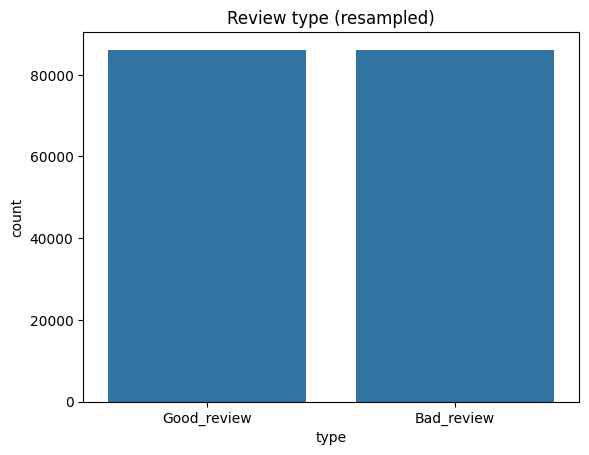

In [ ]:
sns.countplot(
  x='review_type',
  data=df_review_resampled,
  order=df_review_resampled.review_type.value_counts().index
)

plt.xlabel("type")
plt.title("Review type (resampled)");

In [ ]:
from sklearn.preprocessing import LabelEncoder
encoder =LabelEncoder()
encoded_review = encoder.fit_transform(df_review_resampled.review_type.values)

In [ ]:
encoded_review[1:5]

array([1, 1, 1, 1])

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV

train_reviews, test_reviews, y_train, y_test = train_test_split(
    df_review_resampled.Total_Review,
    encoded_review,
    test_size=0.25,
    random_state=42
  )

In [ ]:
train_reviews.shape, test_reviews.shape, y_train.shape, y_test.shape

((129262,), (43088,), (129262,), (43088,))

# Feature Engineering
**TF-IDF**

In [ ]:
import time
from sklearn.feature_extraction.text import TfidfVectorizer

tfv = TfidfVectorizer(min_df=3, max_features=None,
            strip_accents='unicode', analyzer='word', token_pattern=r'\w{1,}',
            ngram_range=(1, 3), use_idf=True, smooth_idf=True, sublinear_tf=True,
            stop_words='english')

# Fit
tfv.fit(list(train_reviews) + list(test_reviews))

# Transform
X_train_tfv = tfv.transform(train_reviews)
X_test_tfv = tfv.transform(test_reviews)

start_time = time.time()

print(f"Execution Time: {time.time() - start_time} seconds")

Execution Time: 7.653236389160156e-05 seconds


**LSA-plot**

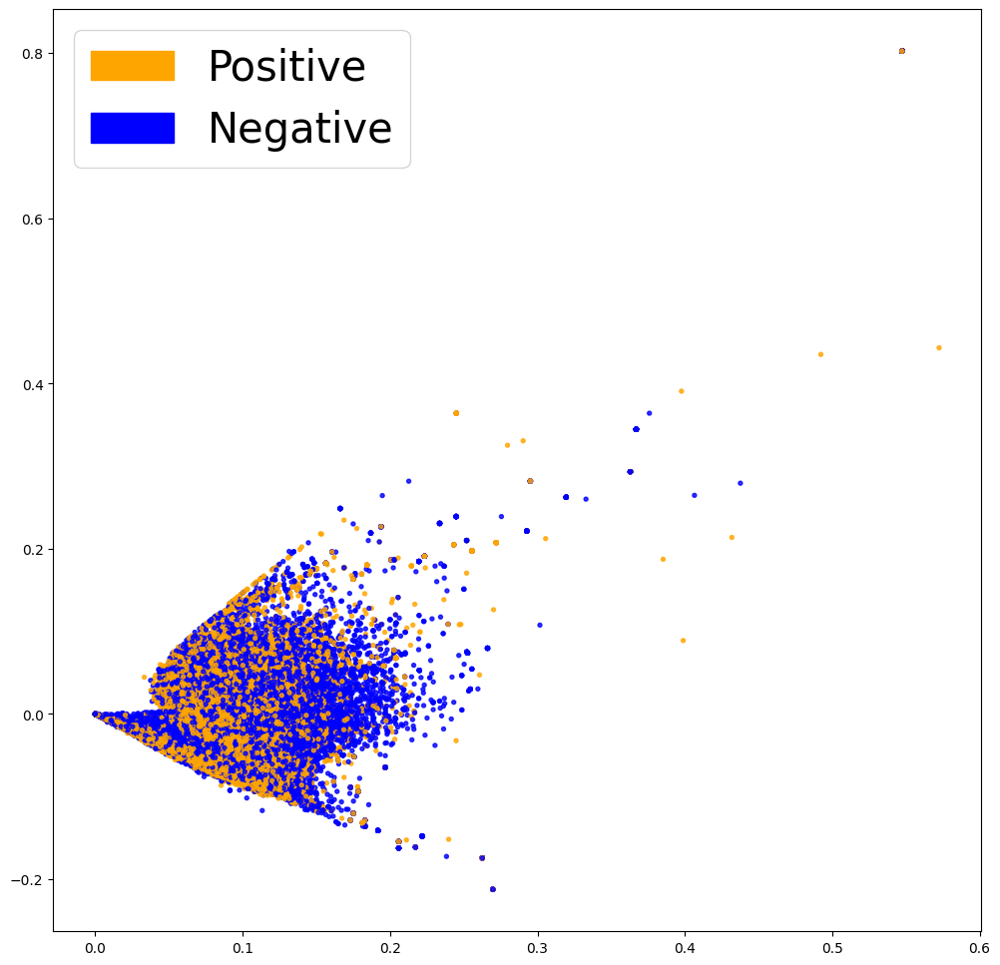

In [ ]:
def plot_LSA(data, labels):
    lsa = TruncatedSVD(n_components=2)
    lsa.fit(data)
    lsa_scores = lsa.transform(data)

    colors = ['orange','blue']
    plt.scatter(lsa_scores[:,0], lsa_scores[:,1], s=8, alpha=.8, c=labels, cmap=matplotlib.colors.ListedColormap(colors))
    orange_patch = mpatches.Patch(color='orange', label='Positive')
    blue_patch = mpatches.Patch(color='blue', label='Negative')
    plt.legend(handles=[orange_patch, blue_patch], prop={'size': 30})

fig = plt.figure(figsize=(12, 12))
plot_LSA(X_train_tfv, y_train)
plt.show()

**Count Feature**

In [ ]:
import time
from sklearn.feature_extraction.text import CountVectorizer

ctv = CountVectorizer(analyzer='word', token_pattern=r'\w{1,}',
            ngram_range=(1, 3), stop_words='english')

ctv.fit(list(train_reviews) + list(test_reviews))

X_train_ctv = ctv.transform(train_reviews)
X_test_ctv = ctv.transform(test_reviews)

start_time = time.time()

print(f"Execution Time: {time.time() - start_time} seconds")


Execution Time: 5.817413330078125e-05 seconds


**LSA-Plot**

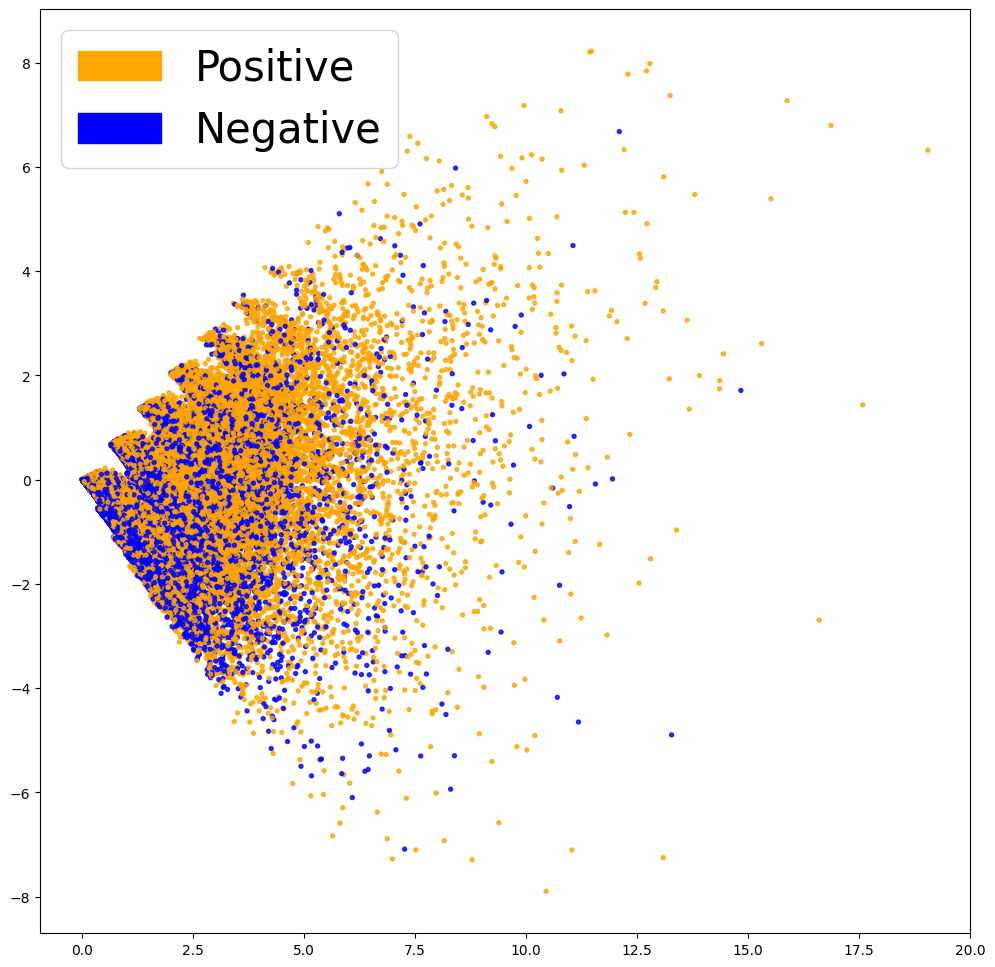

In [ ]:
fig = plt.figure(figsize=(12, 12))
plot_LSA(X_train_ctv, y_train)
plt.show()

In [ ]:
import pickle

with open('ctv.pkl', 'wb') as f:
    pickle.dump(ctv, f)
with open('tfv.pkl', 'wb') as f:
    pickle.dump(tfv, f)

# Models

## Logistic Regression

In [ ]:
def model_predict(clf, X_train, y_train, X_test, y_test):
    clf.fit(X_train, y_train)

    train_pred = clf.predict_proba(X_train)
    test_pred = clf.predict_proba(X_test)

    train_loss = log_loss(y_train, train_pred)
    train_auc = roc_auc_score(y_train, train_pred[:, 1])
    train_acc = accuracy_score(y_train, clf.predict(X_train))

    test_loss = log_loss(y_test, test_pred)
    test_auc = roc_auc_score(y_test, test_pred[:, 1])
    test_acc = accuracy_score(y_test, clf.predict(X_test))

    print(f"Training loss: {train_loss:.3f}")
    print(f"Training AUC: {train_auc:.3f}")
    print(f"Training accuracy: {train_acc:.3f}")

    print(f"Testing loss: {test_loss:.3f}")
    print(f"Testing AUC: {test_auc:.3f}")
    print(f"Testing accuracy: {test_acc:.3f}")

In [ ]:
%%time
lr_model = LogisticRegression(C=1.0, solver='lbfgs', max_iter=1000)

model_predict(lr_model, X_train_ctv,y_train, X_test_ctv, y_test)

Training loss: 0.101
Training AUC: 0.998
Training accuracy: 0.981
Testing loss: 0.445
Testing AUC: 0.899
Testing accuracy: 0.816
CPU times: user 3min 2s, sys: 8.67 s, total: 3min 11s
Wall time: 2min 14s


In [ ]:
%%time

model_predict(lr_model, X_train_tfv,y_train, X_test_tfv, y_test)

Training loss: 0.331
Training AUC: 0.945
Training accuracy: 0.873
Testing loss: 0.398
Testing AUC: 0.903
Testing accuracy: 0.822
CPU times: user 19.3 s, sys: 85.3 ms, total: 19.4 s
Wall time: 11.5 s


In [ ]:
import pickle

with open('logistic_regression_model.pkl', 'wb') as f:
    pickle.dump(lr_model, f)

## XGBoost

In [ ]:
%%time
xgb_model = xgb.XGBClassifier(max_depth=7, n_estimators=200, colsample_bytree=0.8,
                        use_label_encoder=False,
                        subsample=0.8, nthread=10, learning_rate=0.01)

model_predict(xgb_model, X_train_tfv, y_train, X_test_tfv, y_test)

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning:

[15:56:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.




Training loss: 0.550
Training AUC: 0.832
Training accuracy: 0.744
Testing loss: 0.558
Testing AUC: 0.820
Testing accuracy: 0.734
CPU times: user 23min 28s, sys: 9.08 s, total: 23min 37s
Wall time: 14min 38s


In [ ]:
%%time
model_predict(xgb_model, X_train_ctv, y_train, X_test_ctv, y_test)

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning:

[16:14:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.




Training loss: 0.553
Training AUC: 0.830
Training accuracy: 0.743
Testing loss: 0.559
Testing AUC: 0.821
Testing accuracy: 0.735
CPU times: user 1h 33min 59s, sys: 32.9 s, total: 1h 34min 32s
Wall time: 56min 45s


In [ ]:
import xgboost as xgb

xgb_model.save_model('xgboost_model.json')

# Deep Learning Models

In [ ]:
X_train = []
for r in tqdm(train_reviews):
    emb = use(r)
    review_emb = tf.reshape(emb, [-1]).numpy()
    X_train.append(review_emb)

X_train = np.array(X_train)

100%|██████████| 129262/129262 [3:15:03<00:00, 11.05it/s]


In [ ]:
import pickle
import numpy as np

# # Save X_train
# with open('X_train.pkl', 'wb') as f:
#     pickle.dump(X_train, f)

# Load X_train
with open('X_train.pkl', 'rb') as f:
    X_train = pickle.load(f)

# print(np.array_equal(X_train, X_train_loaded)) #Verify if loaded array is same as saved one


True


In [ ]:
X_test = []
for r in tqdm(test_reviews):
    emb = use(r)
    review_emb = tf.reshape(emb, [-1]).numpy()
    X_test.append(review_emb)

X_test = np.array(X_test)

100%|██████████| 43088/43088 [1:06:17<00:00, 10.83it/s]


In [ ]:
import pickle
import numpy as np

# Save X_test
with open('X_test.pkl', 'wb') as f:
    pickle.dump(X_test, f)

# Load X_test
with open('X_test.pkl', 'rb') as f:
    X_test_loaded = pickle.load(f)

print(np.array_equal(X_test, X_test_loaded)) #Verify if loaded array is same as saved one

True


In [ ]:
print(X_train.shape, X_test.shape)
print(y_train.shape, y_test.shape)

(129262, 512) (43088, 512)
(129262,) (43088,)


# Dense Model

In [ ]:
def build_model_1():
    model = Sequential()
    model.add(Dense(256, activation='relu', input_shape=(X_train.shape[1],)))
    model.add(Dropout(0.25))
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(0.25))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(loss='binary_crossentropy',
            metrics=['accuracy'],
            optimizer=Adam(learning_rate=0.001))
    return model

In [ ]:
dense_model = build_model_1()
history = dense_model.fit(
    X_train, y_train,
    epochs=20,
    batch_size=16,
    validation_split=0.2,
    verbose=1,
    shuffle=True
)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/20
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 32s 5ms/step - accuracy: 0.7846 - loss: 0.4506 - val_accuracy: 0.8058 - val_loss: 0.4059
Epoch 2/20
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 27s 4ms/step - accuracy: 0.8093 - loss: 0.4076 - val_accuracy: 0.8095 - val_loss: 0.4052
Epoch 3/20
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 44s 5ms/step - accuracy: 0.8163 - loss: 0.3956 - val_accuracy: 0.8086 - val_loss: 0.4019
Epoch 4/20
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 30s 5ms/step - accuracy: 0.8234 - loss: 0.3848 - val_accuracy: 0.8118 - val_loss: 0.4029
Epoch 5/20
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 28s 4ms/step - accuracy: 0.8293 - loss: 0.3723 - val_accuracy: 0.8132 - val_loss: 0.3978
Epoch 6/20
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 45s 5ms/step - accuracy: 0.8374 - loss: 0.3566 - val_accuracy: 0.8161 - val_loss: 0.3993
Epoch 7/20
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 32s 5ms/step - accuracy: 0.8429 - loss: 0.3457 - val_accuracy: 0.8159 - val_loss: 0.4032
Epoch 8/20
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 30s 5ms/step - accuracy: 0.8479 - loss: 0

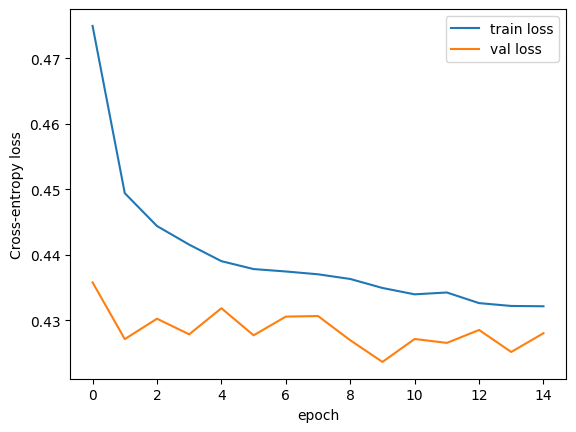

In [ ]:
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.xlabel("epoch")
plt.ylabel("Cross-entropy loss")
plt.legend();

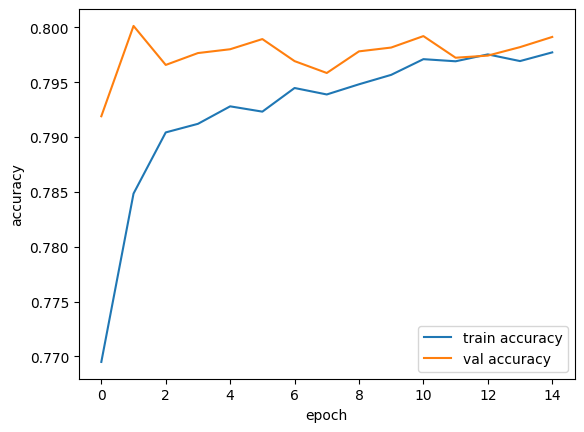

In [ ]:
plt.plot(history.history['accuracy'], label='train accuracy')
plt.plot(history.history['val_accuracy'], label='val accuracy')
plt.xlabel("epoch")
plt.ylabel("accuracy")
plt.legend();

In [ ]:
dense_model.evaluate(X_test, y_test)

1347/1347 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step - accuracy: 0.8087 - loss: 0.5029


[0.5214876532554626, 0.8045163154602051]

In [ ]:
dense_model.save('dense_model.h5')

# CNN

In [ ]:
x_traincnn =np.expand_dims(X_train, axis=2)
x_testcnn= np.expand_dims(X_test, axis=2)

In [ ]:
def build_model_1():
    model = Sequential()
    model.add(Conv1D(256, kernel_size=3, activation='relu', input_shape=(x_traincnn.shape[1], 1)))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Dropout(0.3))
    model.add(Conv1D(128, kernel_size=3, activation='relu'))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Dropout(0.3))
    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))

    model.compile(loss='binary_crossentropy',
            metrics=['accuracy'],
            optimizer=Adam(learning_rate=0.001))
    return model

In [ ]:
cnn_model = build_model_1()
history = cnn_model.fit(
    x_traincnn, y_train,
    epochs=15,
    batch_size=16,
    validation_split=0.2,
    verbose=1,
    shuffle=True
)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/15
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 625s 96ms/step - accuracy: 0.7507 - loss: 0.5017 - val_accuracy: 0.7919 - val_loss: 0.4358
Epoch 2/15
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 691s 98ms/step - accuracy: 0.7839 - loss: 0.4497 - val_accuracy: 0.8001 - val_loss: 0.4271
Epoch 3/15
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 685s 98ms/step - accuracy: 0.7905 - loss: 0.4445 - val_accuracy: 0.7966 - val_loss: 0.4302
Epoch 4/15
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 678s 98ms/step - accuracy: 0.7912 - loss: 0.4410 - val_accuracy: 0.7977 - val_loss: 0.4278
Epoch 5/15
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 684s 98ms/step - accuracy: 0.7944 - loss: 0.4364 - val_accuracy: 0.7980 - val_loss: 0.4318
Epoch 6/15
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 675s 97ms/step - accuracy: 0.7930 - loss: 0.4362 - val_accuracy: 0.7989 - val_loss: 0.4277
Epoch 7/15
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 638s 99ms/step - accuracy: 0.7958 - loss: 0.4352 - val_accuracy: 0.7969 - val_loss: 0.4305
Epoch 8/15
6464/6464 ━━━━━━━━━━━━━━━━━━━━ 690s 100ms/step - accuracy:

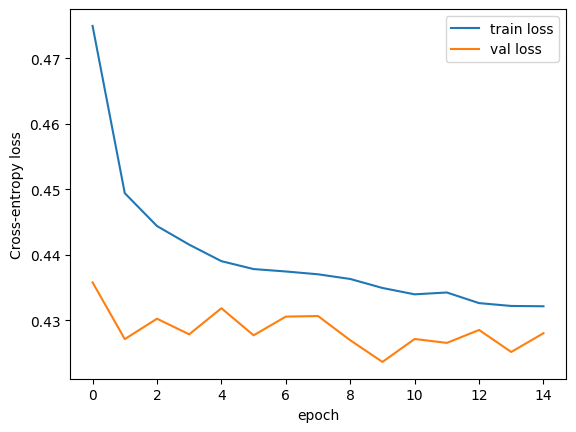

In [ ]:
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.xlabel("epoch")
plt.ylabel("Cross-entropy loss")
plt.legend();

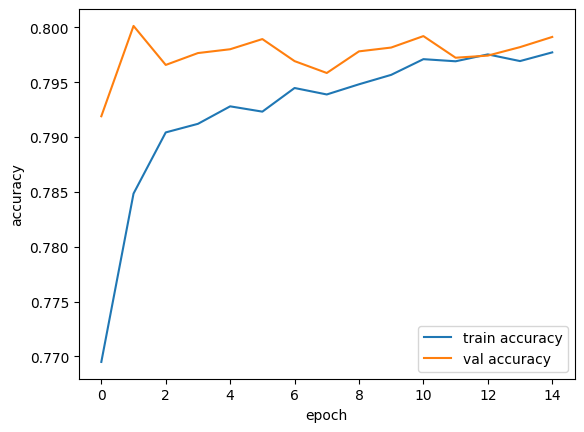

In [ ]:
plt.plot(history.history['accuracy'], label='train accuracy')
plt.plot(history.history['val_accuracy'], label='val accuracy')
plt.xlabel("epoch")
plt.ylabel("accuracy")
plt.legend();

In [ ]:
cnn_model.evaluate(x_testcnn, y_test)

1347/1347 ━━━━━━━━━━━━━━━━━━━━ 65s 48ms/step - accuracy: 0.8011 - loss: 0.4287


[0.4320850372314453, 0.7991319894790649]

In [ ]:
cnn_model.save('cnn_model.h5')

# LSTM Model

In [ ]:
y_train.shape

X_train_reshaped = X_train.reshape(X_train.shape[0] , X_train.shape[1] , 1)
X_test_reshaped = X_test.reshape(X_test.shape[0] , X_test.shape[1] , 1)

In [ ]:
X_test_reshaped.shape

(43088, 512, 1)

In [ ]:
X_train_reshaped.shape

(129262, 512, 1)

In [ ]:
X_train_reshaped = X_train.reshape(X_train.shape[0] , X_train.shape[1] , 1)
X_test_reshaped = X_test.reshape(X_test.shape[0] , X_test.shape[1] , 1)

In [ ]:
X_test_reshaped.shape

(43088, 512, 1)

In [ ]:
X_train_reshaped.shape

(129262, 512, 1)

In [ ]:
# import numpy as np

# ten_percent_train = int(0.1 * X_train_reshaped.shape[0])
# ten_percent_test = int(0.1 * X_test_reshaped.shape[0])

# X_train_10 = X_train_reshaped[:ten_percent_train]
# Y_train_10 = y_train[:ten_percent_train]
# X_test_10 = X_test_reshaped[:ten_percent_test]

# print(X_train_10.shape, Y_train_10.shape, X_test_10.shape)


(12926, 512, 1) (12926,) (4308, 512, 1)


In [ ]:
1,X_train_reshaped.shape[2]

NameError: name 'X_train_reshaped' is not defined

In [ ]:
def build_model_lstm():
    model = Sequential()
    model.add(LSTM(256, activation='sigmoid', return_sequences=True,
                 input_shape=(1, X_train_reshaped.shape[2])
                 ))
    model.add(Dropout(0.5))
    model.add(LSTM(128, activation='sigmoid', return_sequences=False))
    model.add(Dropout(0.3))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy',
            metrics=['accuracy'],
            optimizer=Adam(learning_rate=0.0005))
    return model

In [ ]:
lstm_model = build_model_lstm()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



In [ ]:
%%time

history_lstm_1 = lstm_model.fit(
    X_train_reshaped, y_train,
    epochs=2,
    batch_size=16,
    validation_split=0.2,
    verbose=1,
    shuffle=True
)

NameError: name 'lstm_model' is not defined

In [ ]:
import matplotlib.pyplot as plt

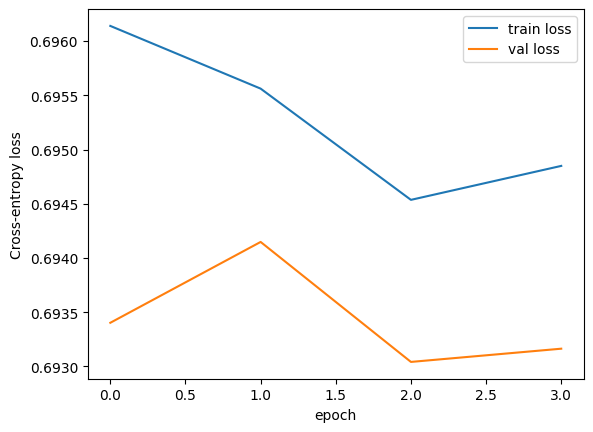

In [ ]:
plt.plot(history_lstm_1.history['loss'], label='train loss')
plt.plot(history_lstm_1.history['val_loss'], label='val loss')
plt.xlabel("epoch")
plt.ylabel("Cross-entropy loss")
plt.legend();

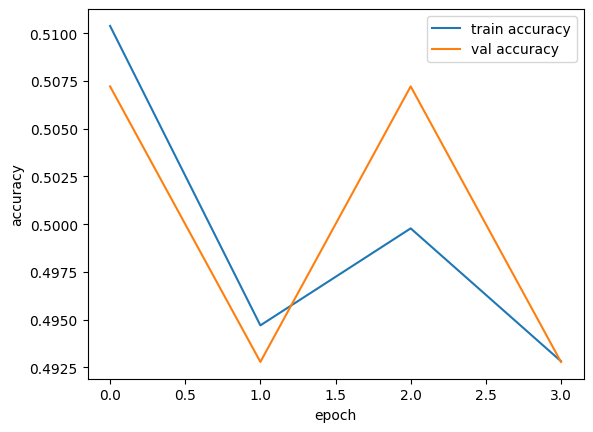

In [ ]:
plt.plot(history_lstm_1.history['accuracy'], label='train accuracy')
plt.plot(history_lstm_1.history['val_accuracy'], label='val accuracy')
plt.xlabel("epoch")
plt.ylabel("accuracy")
plt.legend();

In [ ]:
lstm_model.evaluate(X_test_reshaped, y_test)

1347/1347 ━━━━━━━━━━━━━━━━━━━━ 1056s 784ms/step - accuracy: 0.4958 - loss: 0.6932


[0.6931318044662476, 0.5005801916122437]

In [ ]:
import pickle

# Save the model to a pickle file
with open('model.pkl', 'wb') as f:
    pickle.dump(lstm_model, f)

In [ ]:
# lstm_model.save('lstm_model.h5')

## Test model

In [ ]:
import pickle
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
import tensorflow_hub as hub

lr_model = pickle.load(open('logistic_regression_model.pkl', 'rb'))
xgb_model = xgb.XGBClassifier()
xgb_model.load_model('xgboost_model.json')
cnn_model = load_model('cnn_model.h5')
dense_model = load_model('dense_model.h5')
lstm_model = load_model('lstm_model.h5')

with open('ctv.pkl', 'rb') as f:
    ctv = pickle.load(f)
with open('tfv.pkl', 'rb') as f:
    tfv = pickle.load(f)

/usr/local/lib/python3.11/dist-packages/sklearn/base.py:380: InconsistentVersionWarning: Trying to unpickle estimator LogisticRegression from version 1.2.2 when using version 1.6.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [ ]:
def predict_sentiment(review, model_name):
    if model_name == 'logistic_regression':
        review_vec = tfv.transform([review])
        prediction = lr_model.predict(review_vec)[0]
    elif model_name == 'xgboost':
        review_vec = ctv.transform([review])
        prediction = xgb_model.predict(review_vec)[0]
    elif model_name in ['cnn', 'dense', 'lstm']:
        emb = use(review)
        review_emb = tf.reshape(emb, [-1]).numpy()
        if model_name == 'cnn':
            review_emb = np.expand_dims(review_emb, axis=0)
            review_emb = np.expand_dims(review_emb, axis=2)
            prediction = cnn_model.predict(review_emb)[0][0]
        elif model_name == 'dense':
            review_emb = np.expand_dims(review_emb, axis=0)
            prediction = dense_model.predict(review_emb)[0][0]
        elif model_name == 'lstm':
            review_emb = review_emb.reshape(1, review_emb.shape[0], 1)
            prediction = lstm_model.predict(review_emb)[0][0]

        prediction = 1 if prediction >= 0.5 else 0

    sentiment = "Positive" if prediction == 1 else "Negative"
    return sentiment

# Example usage
review = "The food was terrible. The staff was impolite and service was slow."
print("Logistic Regression:", predict_sentiment(review, 'logistic_regression'))
print("XGBoost:", predict_sentiment(review, 'xgboost'))
print("CNN:", predict_sentiment(review, 'cnn'))
print("Dense:", predict_sentiment(review, 'dense'))
print("LSTM:", predict_sentiment(review, 'lstm'))

Logistic Regression: Negative
XGBoost: Negative
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
CNN: Negative
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
Dense: Negative
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
LSTM: Negative


# RoBERTa BiLSTM Model

In [ ]:
!pip install imblearn

In [ ]:
#general purpose packages
import numpy as np
import os
import codecs
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
import requests
import torch_xla
import torch_xla.core.xla_model as xm
import torch_xla.distributed.parallel_loader as pl
import torch_xla.distributed.xla_multiprocessing as xmp
import torch_xla.utils.utils as xu

import torch

import time
from tqdm import tqdm  # tqdm is a library for displaying progress bars
import random

#data processing
import re, string
import emoji
import nltk
import demoji

from sklearn import preprocessing
from imblearn.over_sampling import RandomOverSampler
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, TensorDataset, ConcatDataset
from torch.cuda.amp import GradScaler, autocast
from torch.utils.data import Dataset
import torch.nn.functional as F
import torch.nn as nn

#Naive Bayes
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.naive_bayes import MultinomialNB

#transformers
from transformers import BertTokenizerFast
from transformers import TFBertModel
from transformers import RobertaTokenizerFast
from transformers import TFRobertaModel
from transformers import AutoModelForSequenceClassification
from transformers import TFAutoModelForSequenceClassification
from transformers import AutoTokenizer, AutoConfig, RobertaTokenizer, RobertaForSequenceClassification
from torch.optim import AdamW
from pytorch_lamb import Lamb
from transformers import RobertaModel


#keras
import tensorflow as tf
from tensorflow import keras


#metrics
from sklearn.metrics import accuracy_score, f1_score
from sklearn.metrics import classification_report, confusion_matrix
from scipy.special import softmax

#set style for plots
# sns.set_style("whitegrid")
sns.set_theme(style="whitegrid")
sns.despine()
# plt.style.use("seaborn-whitegrid")
plt.rc("figure", autolayout=True)
plt.rc("axes", labelweight="bold", labelsize="large", titleweight="bold", titlepad=10)

#pararelism
os.environ["TOKENIZERS_PARALLELISM"] = "true"

<Figure size 640x480 with 0 Axes>

In [ ]:
#set seed for reproducibility
seed=42

# Set seed for numpy
np.random.seed(seed)

# Set seed for python built-in random library
random.seed(seed)

# Set seed for tensorflow
tf.random.set_seed(seed)

# Set seed for pytorch
torch.manual_seed(seed)

In [ ]:
def conf_matrix(y, y_pred, title):
    fig, ax =plt.subplots(figsize=(5,5))
    labels = ['Bad_review', 'Good_review']
    ax=sns.heatmap(confusion_matrix(y, y_pred), annot=True, cmap="Blues", fmt='g', cbar=False, annot_kws={"size":25})
    plt.title(title, fontsize=20)
    ax.xaxis.set_ticklabels(labels, fontsize=17)
    ax.yaxis.set_ticklabels(labels, fontsize=17)
    ax.set_ylabel('Test', fontsize=20)
    ax.set_xlabel('Predicted', fontsize=20)
    plt.show()

In [ ]:
from sklearn.model_selection import train_test_split

# Assuming df_review_resampled is your cleaned and resampled hotel reviews DataFrame
# It should contain at least these columns: "Total_Review" for text and "review_type" for labels

# First, split into train (75%) and test (25%)
df_train, df_test = train_test_split(df_review_resampled, test_size=0.25, random_state=42)
# Then, further split the train set to create a validation set (20% of train)
df_train_splitted, df_val_splitted = train_test_split(df_train, test_size=0.2, random_state=42)

print("Train shape:", df_train_splitted.shape)
print("Validation shape:", df_val_splitted.shape)
print("Test shape:", df_test.shape)

Train shape: (103409, 2)
Validation shape: (25853, 2)
Test shape: (43088, 2)


In [ ]:
from transformers import RobertaModel

class RoBERTaLSTM(nn.Module):
    def __init__(self, checkpoint, num_labels, hidden_dim, lstm_layers, bidirectional, dropout_rate=0.1):
        super(RoBERTaLSTM, self).__init__()
        self.num_labels = num_labels
        self.roberta = RobertaModel.from_pretrained(checkpoint)

        self.lstm = nn.LSTM(self.roberta.config.hidden_size, hidden_dim,
                            num_layers=lstm_layers,
                            bidirectional=bidirectional,
                            batch_first=True,
                            dropout=dropout_rate if lstm_layers > 1 else 0)

        self.dropout = nn.Dropout(dropout_rate)
        self.classifier = nn.Linear(hidden_dim * 2 if bidirectional else hidden_dim, num_labels)

    def forward(self, input_ids, attention_mask, labels=None):
        outputs = self.roberta(input_ids=input_ids, attention_mask=attention_mask)
        sequence_output = outputs.last_hidden_state

        lstm_output, _ = self.lstm(sequence_output)
        pooled_output = torch.mean(lstm_output, dim=1)

        pooled_output = self.dropout(pooled_output)
        logits = self.classifier(pooled_output)

        loss = None
        if labels is not None:
            loss_fn = nn.CrossEntropyLoss()
            loss = loss_fn(logits.view(-1, self.num_labels), labels.view(-1))

        return (loss, logits) if loss is not None else logits

In [ ]:
from transformers import RobertaTokenizerFast

def tokenize_data(df, tokenizer, text_column='Total_Review'):
    input_ids = []
    attention_masks = []
    for text in df[text_column]:
        encoding = tokenizer(text, padding='max_length', max_length=48, truncation=True, return_tensors="pt")
        input_ids.append(encoding.input_ids.squeeze().tolist())
        attention_masks.append(encoding.attention_mask.squeeze().tolist())
    df['input_ids'] = input_ids
    df['attention_masks'] = attention_masks
    return df

# Initialize the tokenizer
tokenizer = RobertaTokenizerFast.from_pretrained('roberta-base') # or any other roberta checkpoint you prefer

# Tokenize data in each split, specifying the correct text column
df_train_tokenized = tokenize_data(df_train_splitted.copy(), tokenizer, text_column='Total_Review')
df_valid_tokenized = tokenize_data(df_val_splitted.copy(), tokenizer, text_column='Total_Review')
df_test_tokenized  = tokenize_data(df_test.copy(), tokenizer, text_column='Total_Review')

In [ ]:
from torch.utils.data import Dataset

class SentimentDataset(Dataset):
    def __init__(self, df):
        # Convert columns to lists
        self.input_ids = df['input_ids'].tolist()
        self.attention_masks = df['attention_masks'].tolist()
        # Map the review_type to numerical labels: adjust if needed
        self.labels = df['review_type'].map({'Bad_review': 0, 'Good_review': 1}).tolist()

    def __len__(self):
        return len(self.input_ids)

    def __getitem__(self, idx):
        return (
            torch.tensor(self.input_ids[idx], dtype=torch.long),
            torch.tensor(self.attention_masks[idx], dtype=torch.long),
            torch.tensor(self.labels[idx], dtype=torch.long)
        )

# Initialize datasets
train_dataset = SentimentDataset(df_train_tokenized)
val_dataset   = SentimentDataset(df_valid_tokenized)
test_dataset  = SentimentDataset(df_test_tokenized)

print("Train dataset size:", len(train_dataset))
print("Validation dataset size:", len(val_dataset))
print("Test dataset size:", len(test_dataset))

Train dataset size: 103409
Validation dataset size: 25853
Test dataset size: 43088


In [ ]:
import torch
from torch.utils.data import DataLoader
from tqdm import tqdm
from sklearn.metrics import f1_score, classification_report
from torch.optim import Adam

# Try to import XLA for TPU; if not available, we'll default to CUDA/CPU.
try:
    import torch_xla
    import torch_xla.core.xla_model as xm
    import torch_xla.distributed.parallel_loader as pl
    TPU_AVAILABLE = True
except ImportError:
    TPU_AVAILABLE = False

# Set device based on availability of TPU
if TPU_AVAILABLE:
    device = xm.xla_device()
    print(f"Using TPU device: {device}")
else:
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

# Create standard PyTorch DataLoaders
bs = 16
# Using num_workers=0 for stability; you can adjust if you face issues.
train_loader = DataLoader(train_dataset, batch_size=bs, shuffle=True, num_workers=0)
val_loader   = DataLoader(val_dataset, batch_size=bs, shuffle=False, num_workers=0)
test_loader  = DataLoader(test_dataset, batch_size=bs, shuffle=False, num_workers=0)

# Note:
# When iterating in training:
# if TPU is available, wrap the loader with pl.MpDeviceLoader, e.g.:
#    for batch in pl.MpDeviceLoader(train_loader, device):
# else simply iterate over train_loader:
#    for batch in train_loader:

Using device: xla:0


In [ ]:
!ls -lh best_model_weights.pth

-rw-r--r-- 1 root root 774M Apr 12 17:39 best_model_weights.pth


In [ ]:
import torch
from torch.optim import Adam
from tqdm import tqdm
from sklearn.metrics import f1_score
# First, try importing TPU (PyTorch/XLA) libraries
try:
    import torch_xla
    import torch_xla.core.xla_model as xm
    import torch_xla.distributed.parallel_loader as pl
    TPU_AVAILABLE = True
except ImportError:
    TPU_AVAILABLE = False

# Set device based on availability of TPU:
if TPU_AVAILABLE:
    device = xm.xla_device()
    print(f"Using TPU device: {device}")
else:
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

# Define hyperparameters (adjust as needed)
checkpoint = 'roberta-base'  # Pre-trained model checkpoint
num_labels = 2               # For binary classification (e.g., Bad_review vs Good_review)
hidden_dim = 128
lstm_layers = 1
bidirectional = True

# Instantiate and move model to device
model = RoBERTaLSTM(checkpoint, num_labels, hidden_dim, lstm_layers, bidirectional).to(device)

# Optimizer (Adam is fine)
optimizer = Adam(model.parameters(), lr=1e-4)

# Early stopping parameters
patience = 5
best_val_loss = float('inf')
patience_counter = 0
best_f1 = 0
best_epoch = 0

# Create standard DataLoaders (assumed previously defined: train_loader, val_loader, test_loader)
bs = 16
# (Here, num_workers is set to 0 for stability in both cases.)
# (You should have defined train_loader, val_loader, and test_loader earlier.)
# For TPU, wrap the DataLoaders with the XLA wrapper.
if TPU_AVAILABLE:
    train_loader_wrapped = pl.MpDeviceLoader(train_loader, device)
    val_loader_wrapped   = pl.MpDeviceLoader(val_loader, device)
else:
    train_loader_wrapped = train_loader
    val_loader_wrapped   = val_loader

# Training loop
epochs = 100
for epoch in range(epochs):
    total_loss = 0
    all_preds = []
    all_true_labels = []
    model.train()

    # Iterate over wrapped DataLoader (TPU or fallback)
    for batch in tqdm(train_loader_wrapped, desc=f"Epoch {epoch+1}/{epochs}"):
        inputs, masks, labels = batch
        inputs, masks, labels = inputs.to(device), masks.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(input_ids=inputs, attention_mask=masks, labels=labels)
        loss = outputs[0] if isinstance(outputs, tuple) else None

        if loss is not None:
            loss.backward()
            # For TPU use XLA optimizer step; else, use standard step.
            if TPU_AVAILABLE:
                xm.optimizer_step(optimizer)
                xm.mark_step()  # Ensure proper XLA graph execution
            else:
                optimizer.step()
            total_loss += loss.item()

            logits = outputs[1] if isinstance(outputs, tuple) else outputs
            preds = torch.argmax(logits, dim=1)
            all_preds.extend(preds.cpu().numpy())
            all_true_labels.extend(labels.cpu().numpy())

    # Calculate training metrics
    train_f1 = f1_score(all_true_labels, all_preds, average='weighted')
    # When using TPU, len(train_loader_wrapped) may differ, but using the original loader's length is fine.
    avg_loss = total_loss / (len(train_loader) if not TPU_AVAILABLE else len(train_loader_wrapped))
    print(f"Epoch {epoch+1}/{epochs} - Train Loss: {avg_loss:.4f}, Train F1: {train_f1:.4f}")

    # Validation phase
    model.eval()
    total_val_loss = 0
    all_val_preds = []
    all_val_labels = []

    with torch.no_grad():
        for batch in tqdm(val_loader_wrapped, desc=f"Validating Epoch {epoch+1}/{epochs}"):
            inputs, masks, labels = batch
            inputs, masks, labels = inputs.to(device), masks.to(device), labels.to(device)
            outputs = model(input_ids=inputs, attention_mask=masks, labels=labels)
            loss = outputs[0] if isinstance(outputs, tuple) else None

            if loss is not None:
                total_val_loss += loss.item()
                logits = outputs[1] if isinstance(outputs, tuple) else outputs
                preds = torch.argmax(logits, dim=1)
                all_val_preds.extend(preds.cpu().numpy())
                all_val_labels.extend(labels.cpu().numpy())

    val_f1 = f1_score(all_val_labels, all_val_preds, average='macro')
    avg_val_loss = total_val_loss / (len(val_loader) if not TPU_AVAILABLE else len(val_loader_wrapped))
    print(f"Validation - Epoch {epoch+1}/{epochs} - Loss: {avg_val_loss:.4f}, F1: {val_f1:.4f}\n")

    # Early stopping check
    if val_f1 > best_f1:
        best_f1 = val_f1
        patience_counter = 0
        torch.save(model.state_dict(), 'best_model_weights.pth')
        print(f"✅ Saved best model weights at epoch {epoch+1}")
        best_epoch = epoch + 1
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print("🛑 Early stopping triggered")
            break

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-base and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Epoch 1/100:  69%|██████▉   | 4474/6464 [58:19<25:42,  1.29it/s]

In [ ]:
print(f"Best epoch: {best_epoch}, best validation F1: {best_f1:.4f}")

Best epoch: 3, best validation F1: 0.7598


In [ ]:
# Evaluate the model after training on the test set
model.eval()
all_preds = []
all_true_labels = []

for batch in tqdm(test_loader, desc="Evaluating"):
    inputs, masks, labels = batch
    inputs, masks, labels = inputs.to(device), masks.to(device), labels.to(device)

    with torch.no_grad():
        outputs = model(input_ids=inputs, attention_mask=masks, labels=labels)
        logits = outputs[1] if isinstance(outputs, tuple) else outputs

    preds = torch.argmax(logits, dim=1)
    all_preds.extend(preds.cpu().numpy())
    all_true_labels.extend(labels.cpu().numpy())

Evaluating: 100%|██████████| 2693/2693 [06:02<00:00,  7.43it/s]


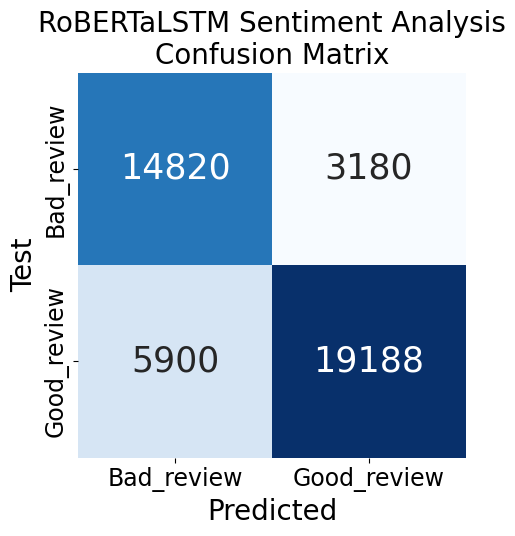

In [ ]:
# Replace conf_matrix with your confusion matrix plotting function if needed
conf_matrix(all_true_labels, all_preds, 'RoBERTaLSTM Sentiment Analysis\nConfusion Matrix')

In [ ]:
# Update class names to match your dataset; assuming 0 is "Bad_review" and 1 is "Good_review"
class_names = ['Bad_review', 'Good_review']
print(classification_report(all_true_labels, all_preds, target_names=class_names))

              precision    recall  f1-score   support

  Bad_review       0.72      0.82      0.77     18000
 Good_review       0.86      0.76      0.81     25088

    accuracy                           0.79     43088
   macro avg       0.79      0.79      0.79     43088
weighted avg       0.80      0.79      0.79     43088



In [ ]:
torch.save(model.state_dict(), "roberta_bilstm.pth")